# NDVI timeseries for Nile Delta

* **Products used:** 
[ls8_sr](https://explorer.digitalearth.africa/ls8_sr), 

* **Special requirements:** An _optional_ description of any special requirements
* **Prerequisites:** An _optional_ list of any notebooks that should be run or content that should be understood prior to launching this notebook


## Background
An *optional* overview of the scientific, economic or environmental management issue or challenge being addressed by Digital Earth Africa. 
For `Beginners_Guide` or `Frequently_Used_Code` notebooks, this may include information about why the particular technique or approach is useful or required. 
If you need to cite a scientific paper or link to a website, use a persistent DOI link if possible and link in-text (e.g. [Dhu et al. 2017](https://doi.org/10.1080/20964471.2017.1402490)).

## Description
A _compulsory_ description of the notebook, including a brief overview of how Digital Earth Africa helps to address the problem set out above.
It can be good to include a run-down of the tools/methods that will be demonstrated in the notebook:

1. First we do this
2. Then we do this
3. Finally we do this

***

## Getting started

Provide any particular instructions that the user might need, e.g. To run this analysis, run all the cells in the notebook, starting with the "Load packages" cell. 

### Load packages
Import Python packages that are used for the analysis.

Use standard import commands; some are shown below. 
Begin with any `iPython` magic commands, followed by standard Python packages, then any additional functionality you need from the `Tools` package.

In [1]:
%matplotlib inline

import datacube
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt

from IPython.display import Image
from deafrica_tools.plotting import display_map, xr_animation
from deafrica_tools.datahandling import load_ard
from deafrica_tools.bandindices import calculate_indices
from deafrica_tools.dask import create_local_dask_cluster
from datacube.utils.cog import write_cog

### Connect to the datacube

Connect to the datacube so we can access DE Africa data.
The `app` parameter is a unique name for the analysis which is based on the notebook file name.

In [2]:
dc = datacube.Datacube(app='NDVI_Nile')

In [3]:
create_local_dask_cluster()

Client Scheduler: tcp://127.0.0.1:37833 Dashboard: /user/mickwelli/proxy/8787/status,Cluster Workers: 1 Cores: 2 Memory: 13.11 GB


In [16]:
lat,lon = 28.4788, 30.5782

buffer = 0.03

time = ('2013-01-01', '2021-12-31')

products = ['ls8_sr']

output_crs = 'epsg:6933'

#join lat, lon, buffer to get bounding box
lon_range = (lon - buffer, lon + buffer)
lat_range = (lat + buffer, lat - buffer)

In [17]:
display_map(lon_range, lat_range)

In [18]:
ds = load_ard(dc=dc, 
              products=products,
              min_gooddata=0.99, 
              measurements=['red', 'green', 'blue', 'nir','swir_1', 'swir_2'],
              output_crs=output_crs,
              time = time,
              resolution = (-30,30),
              x = lon_range,
              y = lat_range,
              group_by = 'solar_day',
              dask_chunks={'x': 3000, 'y': 3000})

/home/jovyan/Tools/deafrica_tools/datahandling.py:238: UserWarning: Setting 'min_gooddata' percentage to > 0.0 will cause dask arrays to compute when loading pixel-quality data to calculate 'good pixel' percentage. This can slow the return of your dataset.
  warnings.warn(


Using pixel quality parameters for USGS Collection 2
Finding datasets
    ls8_sr


/home/jovyan/Tools/deafrica_tools/datahandling.py:474: FutureWarning: xarray.ufuncs is deprecated. Instead, use numpy ufuncs directly.
  pq_mask = xr.ufuncs.logical_or(pq_mask, pq_mask)
/env/lib/python3.8/site-packages/xarray/core/dataarray.py:3088: FutureWarning: xarray.ufuncs is deprecated. Instead, use numpy ufuncs directly.
  f(self.variable, other_variable)
/env/lib/python3.8/site-packages/xarray/core/variable.py:2420: FutureWarning: xarray.ufuncs is deprecated. Instead, use numpy ufuncs directly.
  f(self_data, other_data) if not reflexive else f(other_data, self_data)


Counting good quality pixels for each time step
Filtering to 329 out of 393 time steps with at least 99.0% good quality pixels
Applying pixel quality/cloud mask
Re-scaling Landsat C2 data
Returning 329 time steps as a dask array


In [19]:
NDVI = calculate_indices(ds, index="NDVI", collection='c2')

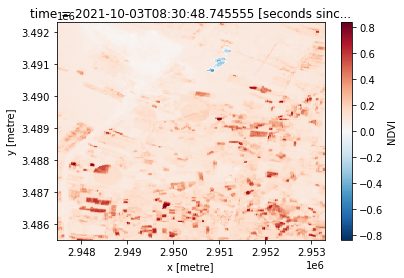

In [27]:
NDVI.NDVI[320].plot()

Exporting animation to NDVI_Nile_Delta.gif


  0%|          | 0/329 (0.0 seconds remaining at ? frames/s)

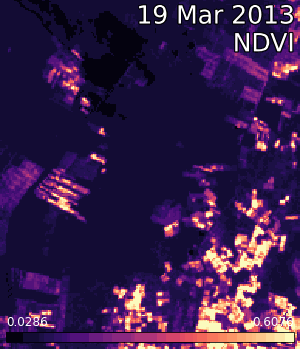

In [21]:
xr_animation(ds=NDVI,
             bands=['NDVI'], 
             
             output_path='NDVI_Nile_Delta.gif',
             width_pixels=300,
             show_text='NDVI',
             percentile_stretch=(0.01, 0.99),
             annotation_kwargs={'fontsize': 25}) 

# Plot animated gif
plt.close()
Image(filename='NDVI_Nile_Delta.gif')

Exporting animation to RGB_Nile_Delta.gif


  0%|          | 0/329 (0.0 seconds remaining at ? frames/s)

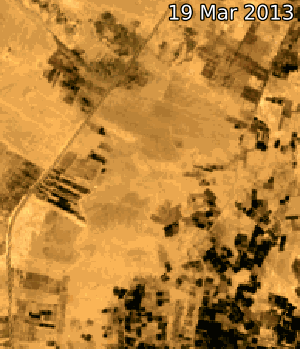

In [23]:
xr_animation(ds=ds, 
             bands=['red', 'green', 'blue'],
             output_path='RGB_Nile_Delta.gif',                                
             width_pixels=300) 

# Plot animated gif
plt.close()
Image(filename='RGB_Nile_Delta.gif')

In [28]:
for i in range(len(NDVI.time)):

    # We will use the date of the satellite image to name the GeoTIFF
    date = ds.isel(time=i).time.dt.strftime('%Y-%m-%d').data
    print(f'Writing {date}')
    
    # Convert current time step into a `xarray.DataArray`
    singleTimestamp = ds.isel(time=i).to_array()

    # Write GeoTIFF  
    write_cog(singleTimestamp,
              fname=f'{date}.tif',
              overwrite=True).compute()

Writing 2013-03-19
Writing 2013-03-24
Writing 2013-04-13
Writing 2013-04-29
Writing 2013-05-22
Writing 2013-06-07
Writing 2013-06-16
Writing 2013-06-23
Writing 2013-07-02
Writing 2013-07-09
Writing 2013-07-18
Writing 2013-07-25
Writing 2013-08-03
Writing 2013-08-10
Writing 2013-08-19
Writing 2013-08-26
Writing 2013-09-04
Writing 2013-09-11
Writing 2013-09-27
Writing 2013-10-06
Writing 2013-10-22
Writing 2013-10-29
Writing 2013-11-14
Writing 2013-12-09
Writing 2013-12-16
Writing 2013-12-25
Writing 2014-01-01
Writing 2014-01-10
Writing 2014-01-17
Writing 2014-02-11
Writing 2014-02-18
Writing 2014-02-27
Writing 2014-03-06
Writing 2014-03-15
Writing 2014-03-22
Writing 2014-03-31
Writing 2014-04-16
Writing 2014-04-23
Writing 2014-05-02
Writing 2014-05-18
Writing 2014-05-25
Writing 2014-06-03
Writing 2014-06-10
Writing 2014-06-19
Writing 2014-06-26
Writing 2014-07-05
Writing 2014-07-12
Writing 2014-07-21
Writing 2014-07-28
Writing 2014-08-06
Writing 2014-08-13
Writing 2014-08-22
Writing 2014

***

## Additional information

**License:** The code in this notebook is licensed under the [Apache License, Version 2.0](https://www.apache.org/licenses/LICENSE-2.0). 
Digital Earth Africa data is licensed under the [Creative Commons by Attribution 4.0](https://creativecommons.org/licenses/by/4.0/) license.

**Contact:** If you need assistance, please post a question on the [Open Data Cube Slack channel](http://slack.opendatacube.org/) or on the [GIS Stack Exchange](https://gis.stackexchange.com/questions/ask?tags=open-data-cube) using the `open-data-cube` tag (you can view previously asked questions [here](https://gis.stackexchange.com/questions/tagged/open-data-cube)).
If you would like to report an issue with this notebook, you can file one on [Github](https://github.com/digitalearthafrica/deafrica-sandbox-notebooks).

**Compatible datacube version:** 

In [ ]:
print(datacube.__version__)

**Last Tested:**

In [ ]:
from datetime import datetime
datetime.today().strftime('%Y-%m-%d')